Visualizations of data produced from Maeda model and relokate package

author : Jessica Gaines

date : 07-2020

In [1]:
import matplotlib.pyplot as plt
import numpy as np
import os
import pandas as pd
from mpl_toolkits.mplot3d import Axes3D
import seaborn as sns
import plotly.express as px
from plotly.subplots import make_subplots
import plotly.graph_objects as go
from IPython.display import Image
import matplotlib.cm as cm
import matplotlib.colors as colors
from makeTrainingData import find_artic_params
import maeda as mda
color_list = ['red','orange','yellow','green','blue','purple','black']

TC = np.array([1,1,0,0], 'float32')
PC = np.array([0.00114,35000,1600,1.5,300000], 'float32')
AM = np.array([0,0,0,0,0,0,0], 'float32') 
anc = 0.0
formant,internal_x,internal_y,external_x,external_y= mda.maedaplant(5,29,29,29,29,TC,PC,AM,anc)
palateCon=np.loadtxt("palate_contour.txt")
find_artic_params(internal_x,internal_y,external_x,external_y,palateCon,plot=True,verbose=True)

ModuleNotFoundError: No module named 'plotly'

In [2]:
# import data into dataframe and verify dataframe dimensions
def read_in_data(path):
    AMs = pd.read_csv(path + '/AM_0.csv',header=None)
    AMs.columns = ['jaw','tongue','shape','apex','lip_ht','lip_pr','larynx'][0:AMs.shape[1]]
    formants = pd.read_csv(path + '/formants_0.csv',header=None,names=range(5))
    task_params = pd.read_csv(path + '/vocal_tract_0.csv',header=None,names=['TTCL','TTCD','TBCL','TBCD','LA','LP'])
    i = 1
    while True:
        try:
            AM = pd.read_csv(path + '/AM_' + str(i) + '.csv',header=None,names=AMs.columns)
            formant = pd.read_csv(path + '/formants_' + str(i) + '.csv',header=None,names=formants.columns)
            task = pd.read_csv(path + '/vocal_tract_' + str(i) + '.csv',header=None,names=task_params.columns)
        except:
            break
        AMs = AMs.append(AM)
        formants = formants.append(formant)
        task_params = task_params.append(task)
        i += 1 
    AMs.reset_index(drop=True, inplace=True)
    formants.reset_index(drop=True, inplace=True)
    task_params.reset_index(drop=True, inplace=True)
    print(AMs.shape)
    print(formants.shape)
    print(task_params.shape)
    return AMs,formants,task_params
AMs,formants,task_params = read_in_data('training_data_files_TB75-180')

(23009, 7)
(23009, 5)
(23009, 6)


In [3]:
# create restricted dataset _r
# filter out a restricted dataset for maeda parameters [-2,2]
AMs_r = AMs.copy()
AMs_r = AMs_r[AMs[:] > -2]
AMs_r = AMs_r[AMs[:] < 2]
AMs_r.dropna(axis=0,how='any',inplace=True)
print(AMs_r.shape)
formants_r = formants.copy()
formants_r = formants_r.iloc[AMs_r.index,:]
print(formants_r.shape)
task_params_r = task_params.copy()
task_params_r = task_params_r.iloc[AMs_r.index,:]
print(task_params_r.shape)

(1203, 7)
(1203, 5)
(1203, 6)


In [4]:
# create dataset with valid configurations perturbed _p
AMs_p,formants_p,task_params_p = read_in_data('training_data_files_TB75-180_explore_valid')

(20000, 7)
(20000, 5)
(20000, 6)


In [5]:
# create restricted dataset _sc (small constriction)
# filter out a restricted dataset for constriction degrees 0-5 mm
task_params_sc = task_params[(task_params['TTCD'] < 5) | (task_params['TBCD'] < 5)]
print(task_params_sc.shape)
print(task_params.shape)
AMs_sc = AMs[(task_params['TTCD'] < 5) | (task_params['TBCD'] < 5)]
formants_sc = formants[(task_params['TTCD'] < 5) | (task_params['TBCD'] < 5)]
print(AMs_sc.shape)
print(formants_sc.shape)

(6777, 6)
(23009, 6)
(6777, 7)
(6777, 5)


In [15]:
# read in dataset from random walks _rw
AMs_rw,formants_rw,task_params_rw = read_in_data('training_data_files_random_walk_seed100')
#AMs_rw2,formants_rw2,task_params_rw2 = read_in_data('training_data_files_random_walk_2')
#AMs_rw = AMs_rw.append(AMs_rw2,ignore_index=True)
#formants_rw = formants_rw.append(formants_rw2,ignore_index=True)
#task_params_rw = task_params_rw.append(task_params_rw2,ignore_index=True)
#print(AMs_rw.shape)
#print(formants_rw.shape)
#print(task_params_rw.shape)

(20010, 6)
(20010, 5)
(20010, 6)


F1 : 448.9147942109609 +/- 151.93046398743587 Hz
F2 : 1379.6801686296667 +/- 387.08791942246427 Hz
F3 : 2333.941761919249 +/- 277.51972281592225 Hz
F4 : 3499.816919466296 +/- 296.8862849811108 Hz
F5 : 4301.477074188361 +/- 431.00416190709217 Hz


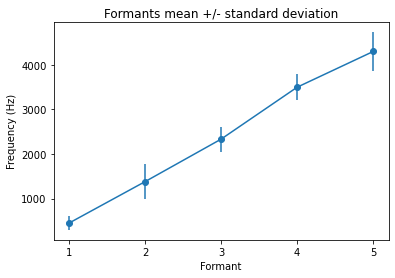

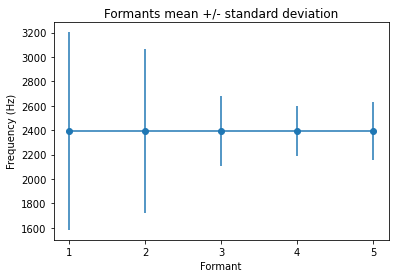

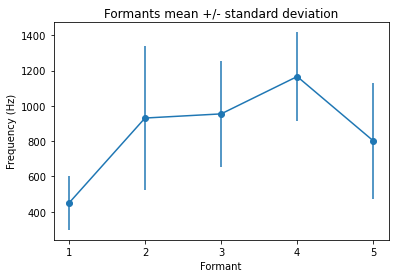

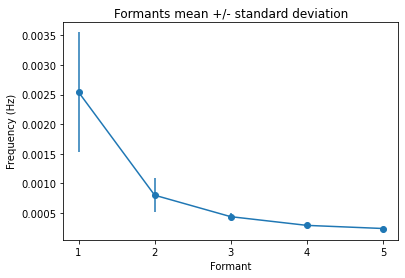

In [7]:
# frequency typical values
def plot_formant_means(df):
    fig = plt.figure()
    plt.scatter(df.columns+1,np.mean(df))
    plt.errorbar(x=df.columns+1,y=np.mean(df),yerr=np.std(df))
    plt.title('Formants mean +/- standard deviation')
    plt.xlabel('Formant')
    plt.xticks([1,2,3,4,5])
    plt.ylabel('Frequency (Hz)')
    plt.show()
# print mean +/- standard deviation for each formant
for f in formants.columns:
    print('F' + str(f+1) + ' : ' + str(np.mean(formants[f])) + ' +/- ' + str(np.std(formants[f])) + ' Hz')
# Un-transformed formants
plot_formant_means(formants)
# Transformation 1: Normalize formants by mean
formants_norm = (formants/np.mean(formants)) * np.mean(np.mean(formants))
plot_formant_means(formants_norm)
# Transformation 2: Formant differences
formants_diff = formants[[0]].copy()
for i in range(0,4):
    formants_diff[i+1] = formants[i+1] - formants[i]
plot_formant_means(formants_diff)
# Transformation 3: 1/x
plot_formant_means(1/formants)

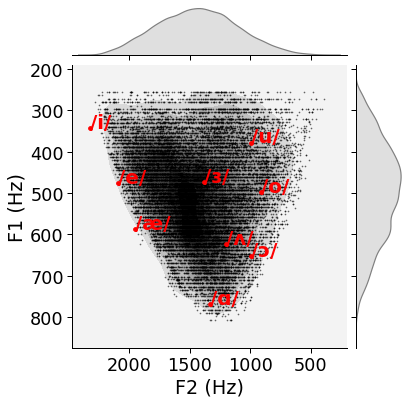

In [13]:
def formant_graph(df,title='',mark_male_vowels=True,mark_female_vowels=True):
    sns.set_context("paper", font_scale=2)
    fig = sns.jointplot(x=1,y=0,data=df,kind='kde',color='gray')
    fig.plot_joint(plt.scatter, c="black", s=2, linewidth=1, marker=".",alpha=0.5)
    fig.fig.suptitle(title)
    ax = fig.fig.axes[0]
    ax.invert_xaxis()
    ax.invert_yaxis()
    s = 20
    if mark_male_vowels:
        male_f1 = [342,476,588,768,652,497,378,623,474]
        male_f2 = [2322,2089,1952,1333,997,910,997,1200,1379]
        blue = 'red'
        plt.scatter(male_f2,male_f1,color=blue,label='Avg. Male',s=15)
        plt.annotate('/i/',(2322,342),color=blue,size=s,weight='bold')
        plt.annotate('/e/',(2089,476),color=blue,size=s,weight='bold')
        plt.annotate('/o/',(910,497),color=blue,size=s,weight='bold')
        plt.annotate('/u/',(997,378),color=blue,size=s,weight='bold')
        plt.annotate('/æ/',(1952,588),color=blue,size=s,weight='bold')
        plt.annotate('/ʌ/',(1200,623),color=blue,size=s,weight='bold')
        plt.annotate('/ɔ/',(997,652),color=blue,size=s,weight='bold')
        plt.annotate('/ɑ/',(1333,768),color=blue,size=s,weight='bold')
        plt.annotate('/ɜ/',(1379,474),color=blue,size=s,weight='bold')
    if mark_female_vowels:
        female_f1 = [437,536,669,936,781,555,459,753,523]
        female_f2 = [2761,2530,2349,1551,1136,1035,1105,1426,1588]
        pink = 'deeppink'
        plt.scatter(female_f2,female_f1,color=pink,label='Avg. Female',s=15)
        plt.annotate('/i/',(2761,437),color=pink,size=s,weight='bold')
        plt.annotate('/e/',(2530,536),color=pink,size=s,weight='bold')
        plt.annotate('/o/',(1035,555),color=pink,size=s,weight='bold')
        plt.annotate('/u/',(1105,459),color=pink,size=s,weight='bold')
        plt.annotate('/æ/',(2349,669),color=pink,size=s,weight='bold')
        plt.annotate('/ʌ/',(1426,753),color=pink,size=s,weight='bold')
        plt.annotate('/ɔ/',(1136,781),color=pink,size=s,weight='bold')
        plt.annotate('/ɑ/',(1551,936),color=pink,size=s,weight='bold')
        plt.annotate('/ɜ/',(1588,523),color=pink,size=s,weight='bold')
    fig.set_axis_labels('F2 (Hz)', 'F1 (Hz)')
    #plt.ylim([1100,100])
    #plt.legend()
    plt.show()
formant_graph(formants_rw,mark_female_vowels=False)

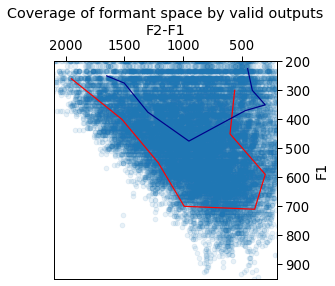

In [16]:
# transformation of formant data
fig = plt.figure(figsize=(4,4))
ax = fig.add_subplot(111)
ax.scatter(formants[1]-formants[0],formants[0],alpha=0.1)
ax.set_xlabel('F2-F1')
ax.set_ylabel('F1')
ax.set_title('Coverage of formant space by valid outputs')
ax.set_xlim([2100,200])
ax.set_ylim([950,200])
ax.yaxis.tick_right()
ax.yaxis.set_label_position("right")
ax.xaxis.tick_top()
ax.xaxis.set_label_position("top")
x = [1950,1520,1210,990,390,300,600,560]
y = [260,400,550,700,710,590,450,300]
ax.plot(x,y,color='red')
x = [1650,1500,1300,950,470,300,410,450]
y = [250,275,375,475,370,350,300,225]
ax.plot(x,y,color='darkblue')
plt.show()
Image(url= "https://sail.usc.edu/~lgoldste/General_Phonetics/Source_Filter/headsize.gif",width=300,height=300)

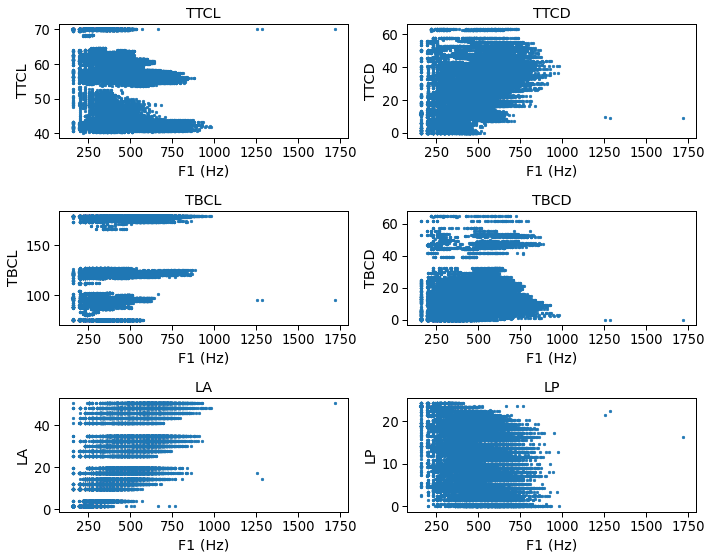

In [17]:
# plot vocal tract parameters used to produce each value of F1 frequency
def task_params_over_formant(formants_df,task_params_df,form):
    fig = plt.figure(figsize=(10,8))
    i = 1
    for t in task_params_df.columns:
        ax = fig.add_subplot(3,2,i)
        ax.scatter(formants_df[form-1],task_params_df[t],marker='.')
        ax.set_xlabel('F' + str(form) + ' (Hz)')
        ax.set_ylabel(t)
        ax.set_title(t)
        i+=1
    plt.tight_layout()
    plt.show()
task_params_over_formant(formants,task_params,1)

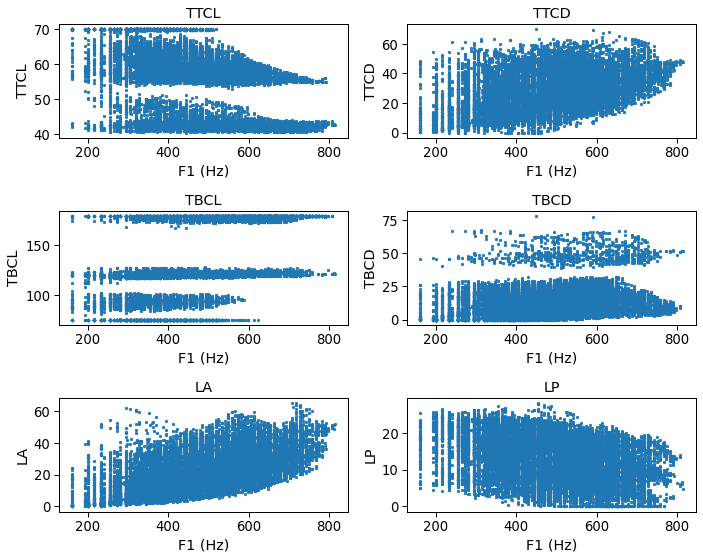

In [18]:
task_params_over_formant(formants_rw,task_params_rw,1)

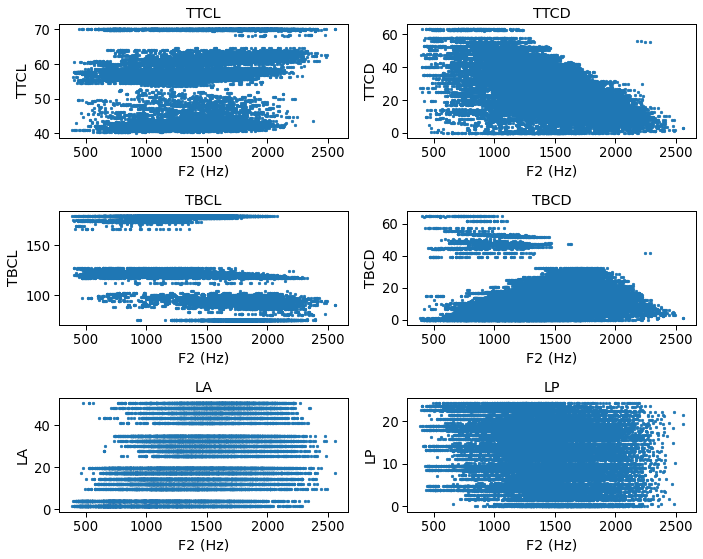

In [19]:
# plot vocal tract parameters used to produce each value of F2 frequency
task_params_over_formant(formants,task_params,2)

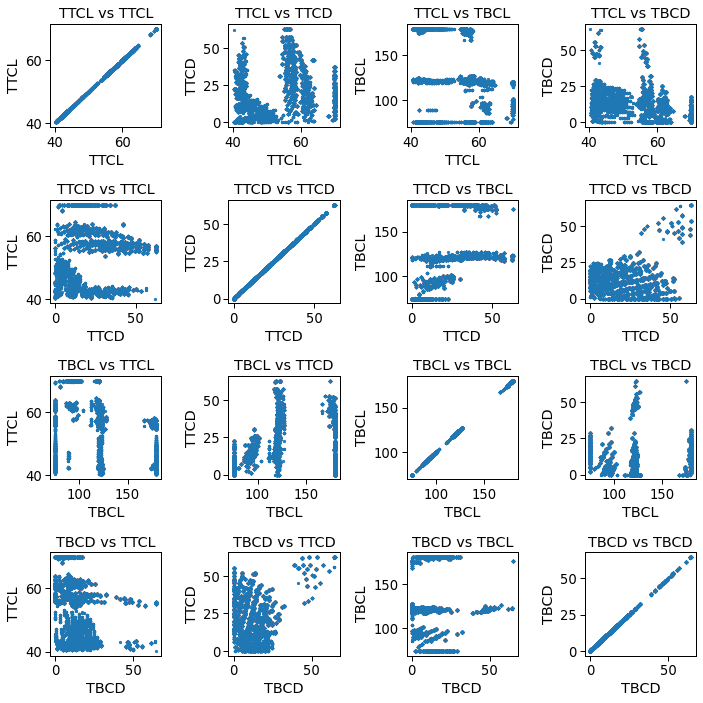

In [20]:
# covariation of each pair of vocal tract parameters
fig = plt.figure(figsize=(10,10))
i = 1
for t1 in ['TTCL','TTCD','TBCL','TBCD']:
    for t2 in ['TTCL','TTCD','TBCL','TBCD']:
        ax = fig.add_subplot(4,4,i)
        ax.scatter(task_params[t1],task_params[t2],marker='.')
        ax.set_xlabel(t1)
        ax.set_ylabel(t2)
        ax.set_title(t1 + ' vs ' + t2)
        i += 1
plt.tight_layout()
plt.show()

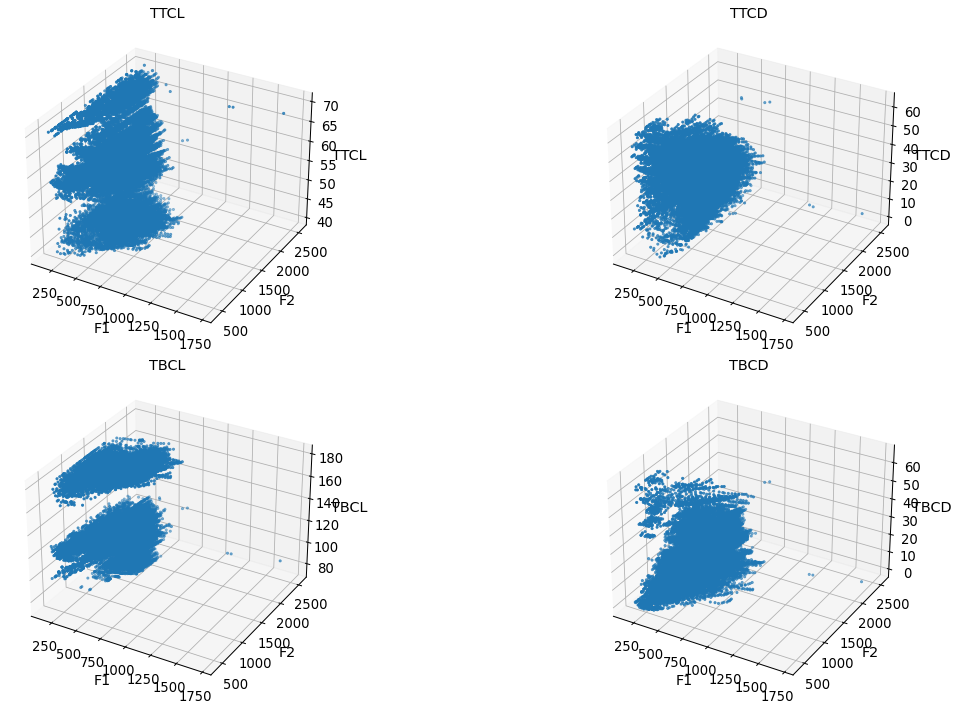

In [21]:
# visualize how variation in task parameter affects coverage of F1-F2 space

fig = plt.figure(figsize=(20,10))
i = 1
for t in ['TTCL','TTCD','TBCL','TBCD']:
    axis = fig.add_subplot(2,2,i, projection='3d')
    axis.scatter(formants[0],formants[1],task_params[t],marker='.')
    axis.set_xlabel('F1')
    axis.set_ylabel('F2')
    axis.set_zlabel(t)
    axis.set_title(t)
    i += 1
plt.tight_layout()
plt.show()


In [22]:
# bin data for color coding in 3d scatterplot
task_params_disc = task_params.copy()
for c in task_params.columns:
    minimum = task_params[c].min()
    maximum = task_params[c].max()
    divisions = np.linspace(minimum,maximum,10)
    task_params_disc[c + '_binned'] = np.digitize(task_params[c],bins=divisions)
task_params_disc.head()

,TTCL,TTCD,TBCL,TBCD,LA,LP,TTCL_binned,TTCD_binned,TBCL_binned,TBCD_binned,LA_binned,LP_binned
0,57.88,18.987214,75.0,23.840787,3.683796,3.877101,6,3,1,4,1,2
1,57.85,18.987070,75.0,23.842265,3.683796,3.877101,6,3,1,4,1,2
2,57.85,18.987125,75.0,23.842777,3.683796,3.877101,6,3,1,4,1,2
3,57.88,18.987214,75.0,23.840787,3.683796,8.550766,6,3,1,4,1,4
4,57.85,18.987070,75.0,23.842265,3.683796,8.550766,6,3,1,4,1,4


In [23]:
# visualize how variation in task parameter affects coverage of F1-F2 space
i = 0
for col in ['TTCL','TTCD','TBCL','TBCD']:
    x = formants[0]
    y = formants[1]
    z = task_params_disc[col]
    hue = task_params_disc[col+'_binned']
    fig = go.Figure(data=[go.Scatter3d(x=x, y=y, z=z,mode='markers',marker=dict(color=hue,size=1))])
    fig.update_layout(
    title={
        'text':col,
        'y':0.9,
        'x':0.5,
        'xanchor':'center',
        'yanchor':'top'},
    scene = dict(
                    xaxis_title='F1',
                    yaxis_title='F2',
                    zaxis_title=col),
                    width=700,
                    margin=dict(r=20, b=10, l=10, t=10),
    font=dict(
        family="Courier New, monospace",
        size=12,
        color="black")
    )
    i += 1
    fig.show()

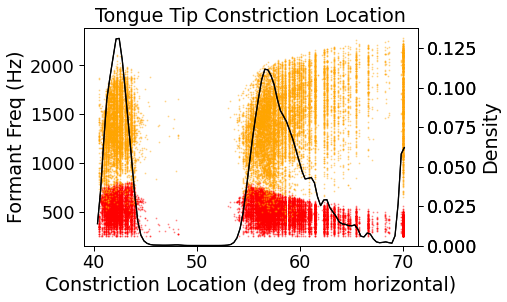

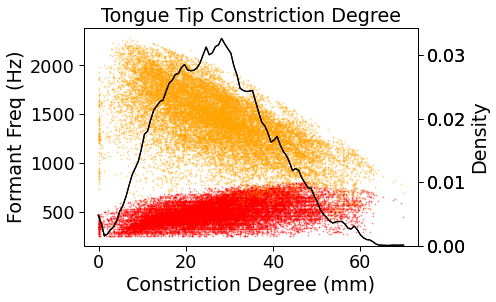

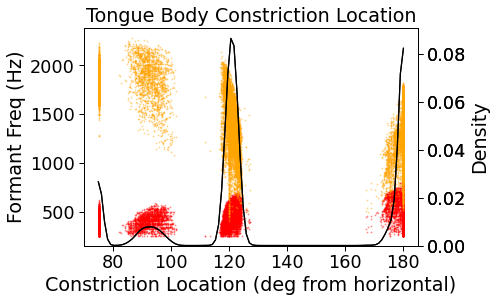

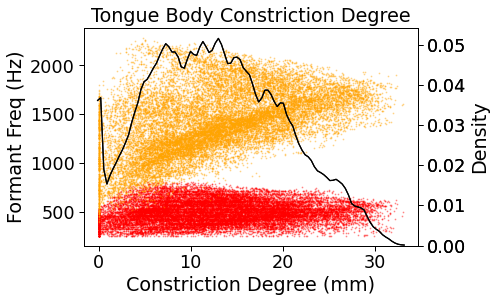

In [14]:
# visualize the spread of each formant as a function of each task parameter
def formant_spread_by_task_param(formants_df,task_params_df):
    which_formants = np.array([1,2])
    #fig = plt.figure(figsize=(15,7))
    i = 1
    for t in ['TTCL','TTCD','TBCL','TBCD']:
        fig = plt.figure()
        ax = fig.add_subplot(1,1,1)
        c = 0
        for f in formants_df.columns[which_formants-1]:
            ax.scatter(task_params_df[t],formants_df[f],color=color_list[c],marker='.',label='F'+str(f+1),s=5,alpha=0.3)
            ax2 = ax.twinx()
            sns.distplot(task_params_df[t],hist=False,kde_kws={'bw':0.04},color='black')
            c += 1
        mn = task_params_df[t].min()
        mx = task_params_df[t].max()
        ax.set_xlim([mn-0.05*(mx-mn),mx+0.05*(mx-mn)])
        i += 1
        #ax.set_title(t)
        if 'CL' in t:
            ax.set_xlabel('Constriction Location (deg from horizontal)')
            ax2.set_xlabel('test')
            if 'TT' in t:
                ax.set_title('Tongue Tip Constriction Location')
            if 'TB' in t:
                ax.set_title('Tongue Body Constriction Location')
        if 'CD' in t:
            ax.set_xlabel('Constriction Degree (mm)')
            ax2.set_xlabel('test')
            if 'TT' in t:
                ax.set_title('Tongue Tip Constriction Degree')
            if 'TB' in t:
                ax.set_title('Tongue Body Constriction Degree')
        ax.set_ylabel('Formant Freq (Hz)')
        ax2.set_ylabel('Density')
        #ax.legend()
        #plt.subplots_adjust(top = 0.99, bottom=0.01, hspace=0.3,wspace=0.4)
        plt.show()
#formant_spread_by_task_param(formants,task_params)
formant_spread_by_task_param(formants_rw,task_params_rw)

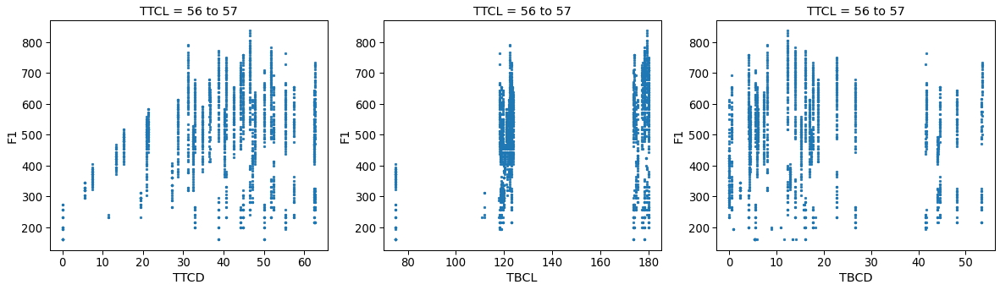

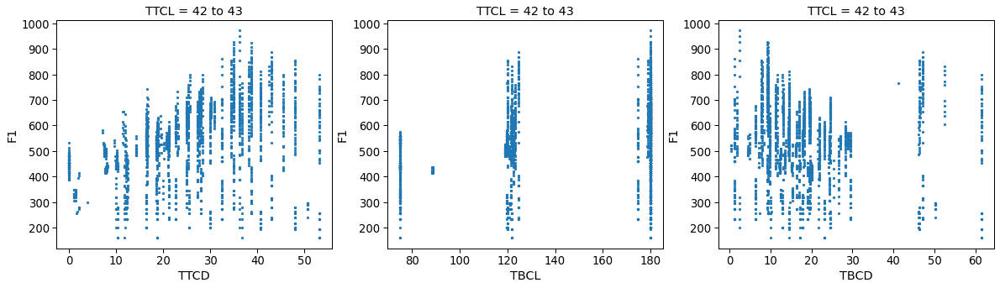

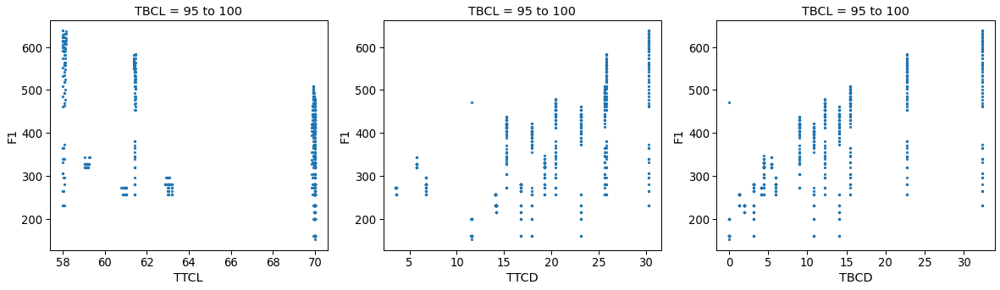

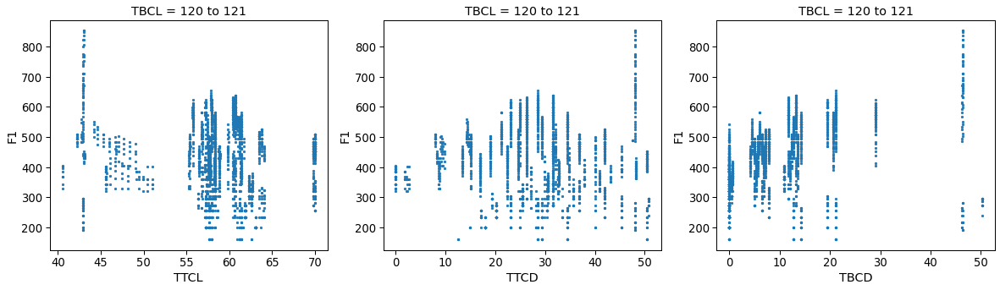

In [25]:
# hold one task parameter ~constant
# visualize how F1 varies with each other task parameter
def visualize_slice(minimum, maximum, col_to_slice):
    task_params_slice = task_params.loc[(task_params[col_to_slice] >= minimum) & (task_params[col_to_slice] <= maximum)]
    formants_slice = formants.loc[(task_params[col_to_slice] >= minimum) & (task_params[col_to_slice] <= maximum)]
    fig = plt.figure(figsize=(20,5))
    i = 1
    other_task_params = list(['TTCL','TTCD','TBCL','TBCD'])
    other_task_params.remove(col_to_slice)
    for t in other_task_params:
        ax = fig.add_subplot(1,3,i)
        ax.scatter(task_params_slice[t],formants_slice[0],marker='.')
        ax.set_xlabel(t)
        ax.set_ylabel('F1')
        ax.set_title(col_to_slice + ' = ' + str(minimum) + ' to ' + str(maximum))
        i += 1
    plt.show()
visualize_slice(56,57,'TTCL')
visualize_slice(42,43,'TTCL')
visualize_slice(95,100,'TBCL')
visualize_slice(120,121,'TBCL')

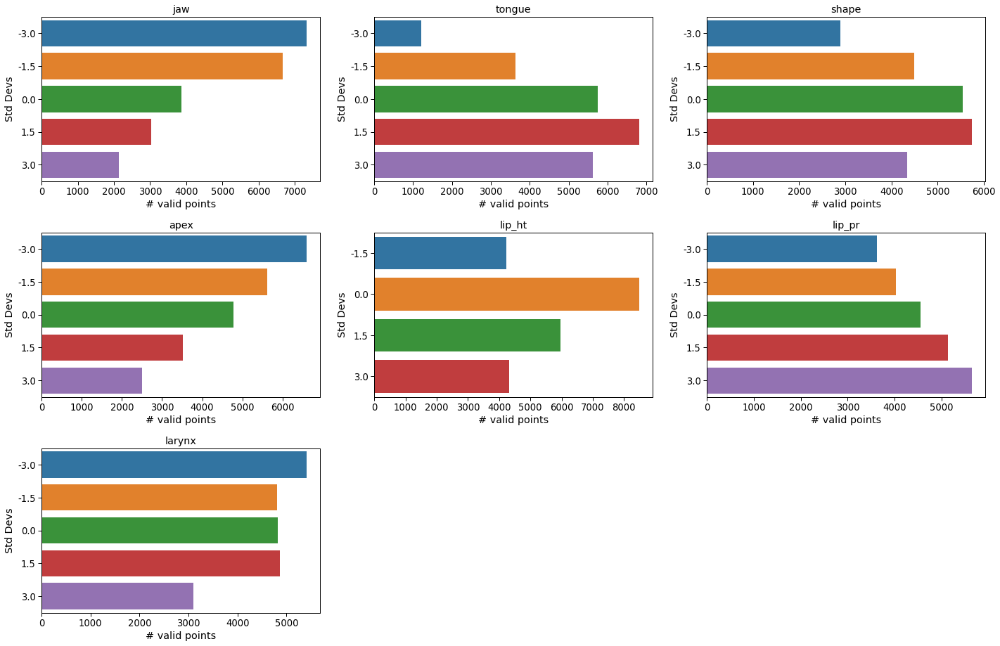

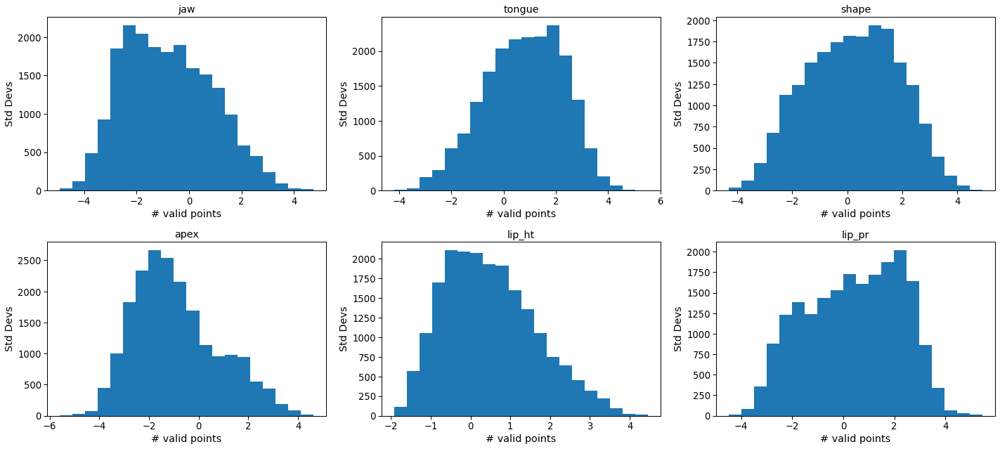

In [26]:
# visualize the density of valid outputs for each articulatory parameter
def one_d_maeda_params(df,plot_type='countplot'):
    fig = plt.figure(figsize=(20,13))
    i = 1
    for am in df.columns:
        ax = fig.add_subplot(3,3,i)
        if plot_type == 'countplot':
            sns.countplot(y=am, data=df)
        elif plot_type == 'hist':
            ax.hist(df[am],bins=20)
        ax.set_title(am)
        ax.set_xlabel('# valid points')
        ax.set_ylabel('Std Devs')
        i += 1
    plt.tight_layout()
    plt.show()
one_d_maeda_params(AMs)
one_d_maeda_params(AMs_rw.iloc[:,0:6],'hist')

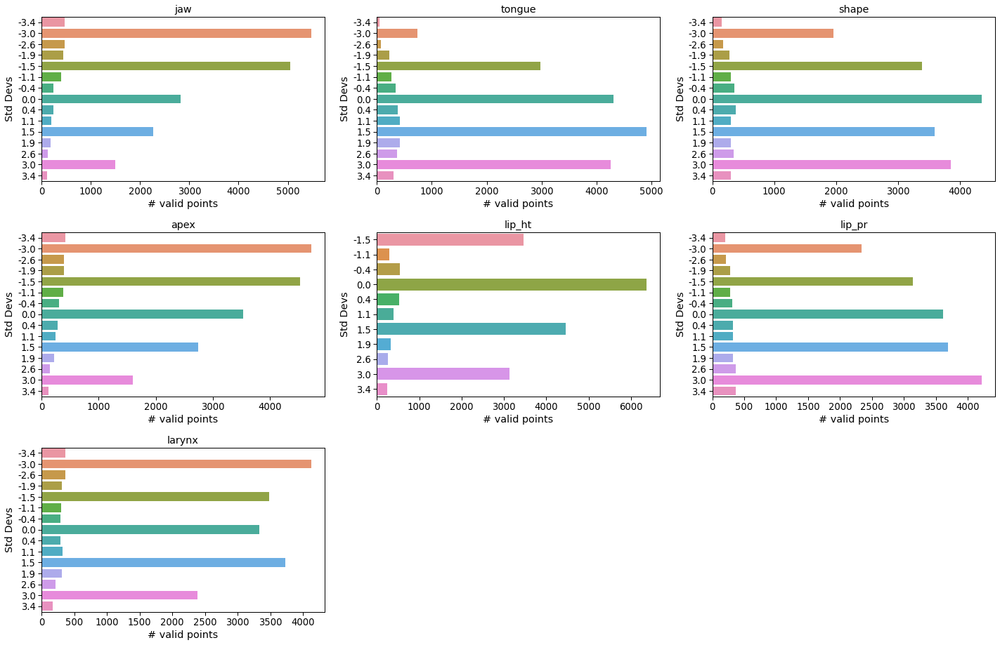

In [27]:
one_d_maeda_params(AMs_p)

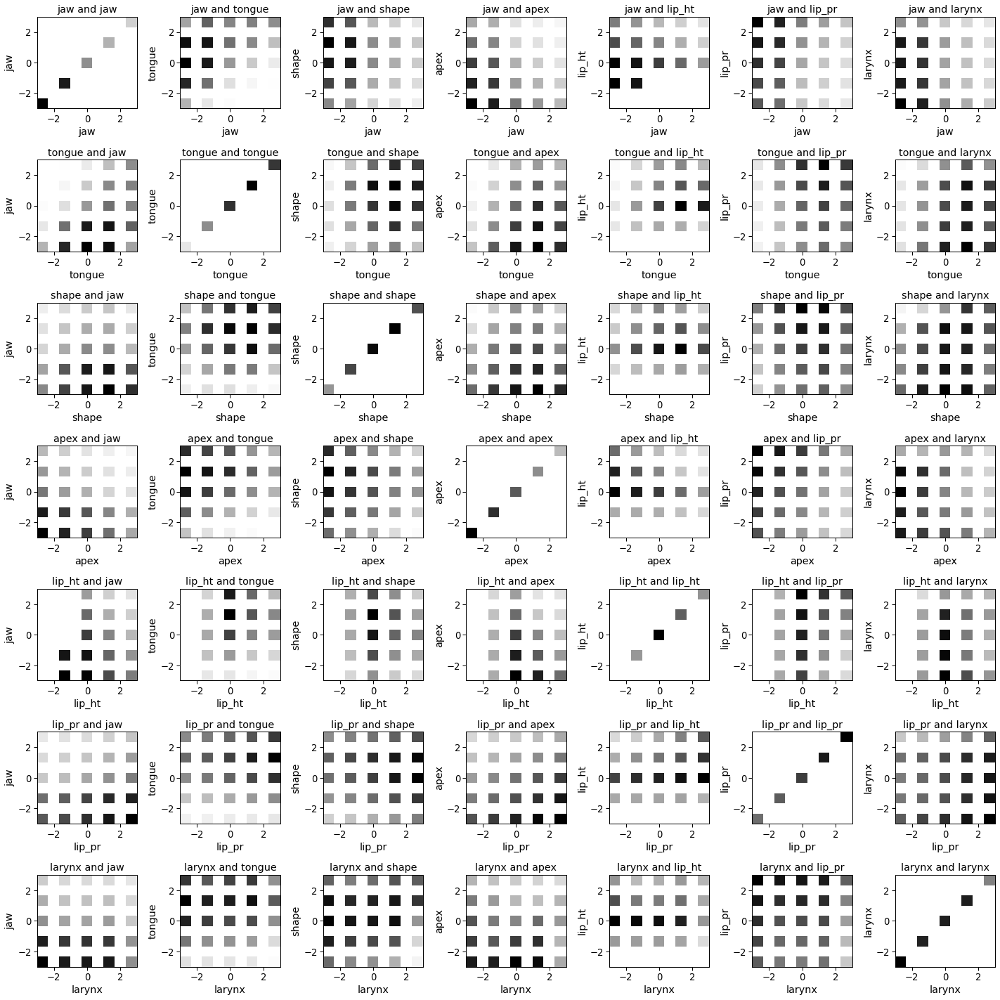

In [14]:
# visualize the density of valid combinations for each pair of articulatory parameters
def two_d_maeda_params(df):
    fig = plt.figure(figsize=(20,20))
    i = 1
    for am1 in df.columns:
        for am2 in df.columns:
            ax = fig.add_subplot(len(df.columns),len(df.columns),i)
            ax.hist2d(df[am1],df[am2],bins=np.linspace(-3,3,10),cmap=plt.cm.Greys)
            ax.set_title(am1 + ' and ' + am2)
            ax.set_xlabel(am1)
            ax.set_ylabel(am2)
            i += 1
    plt.tight_layout()
    plt.show()
two_d_maeda_params(AMs)

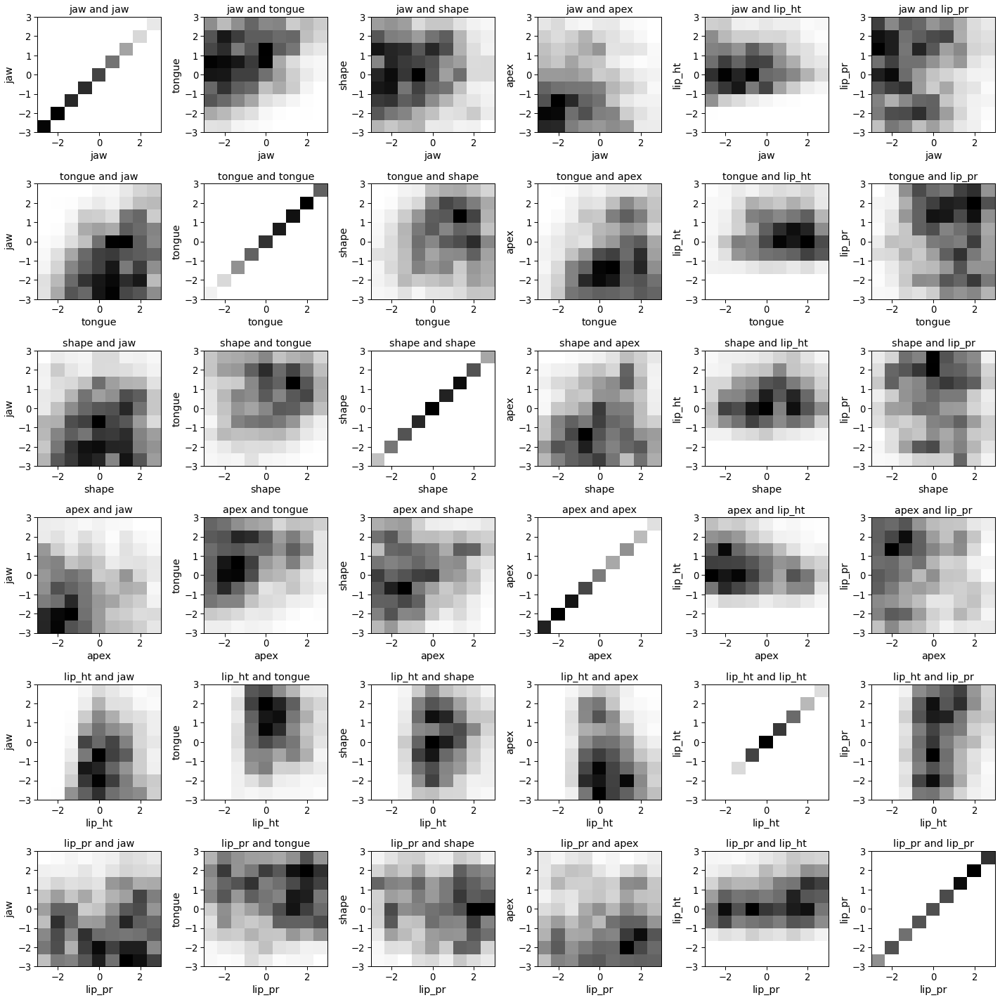

In [15]:
two_d_maeda_params(AMs_rw.iloc[:,0:6])

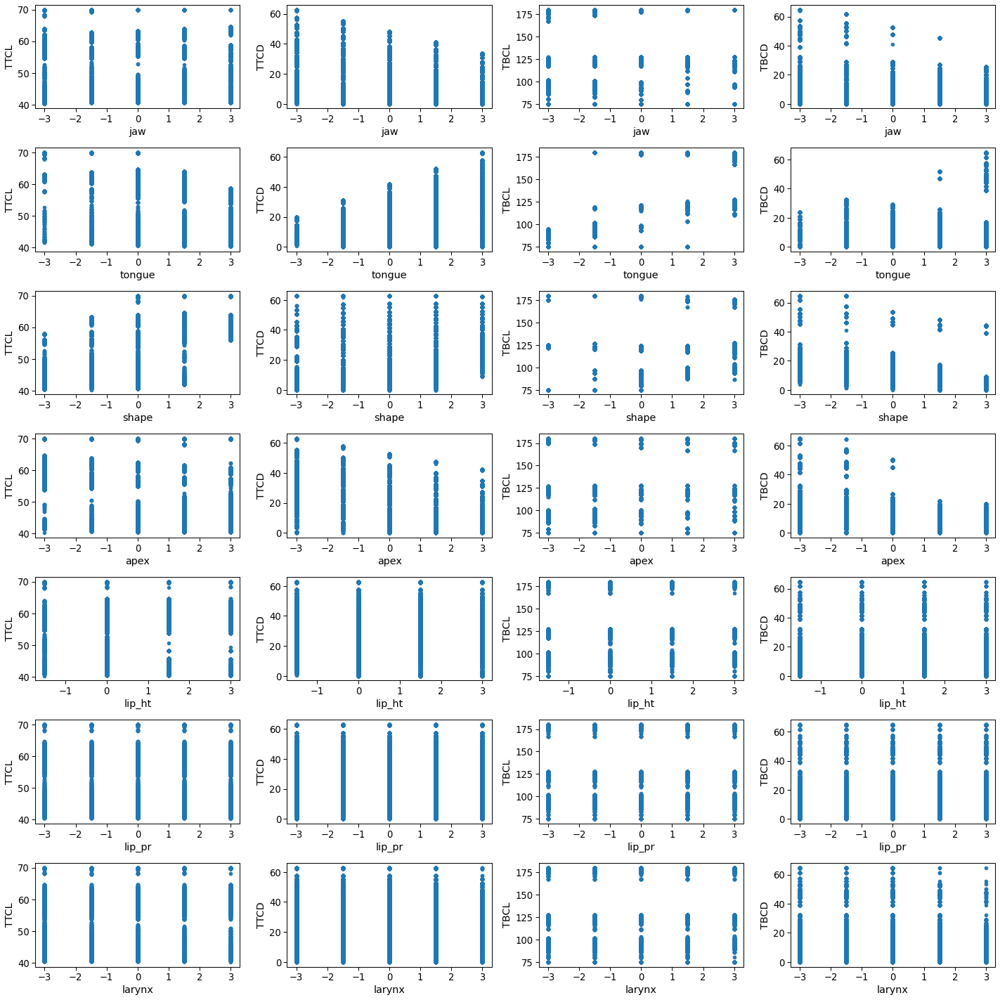

In [30]:
# For each articulatory parameter, visualize the range of valid task parameters
fig = plt.figure(figsize=(20,20))
i = 1
for am in AMs.columns:
    for t in ['TTCL','TTCD','TBCL','TBCD']:
        ax = fig.add_subplot(7,4,i)
        ax.scatter(AMs[am],task_params[t])
        ax.set_xlabel(am)
        ax.set_ylabel(t)
        i += 1
plt.tight_layout()
plt.show()

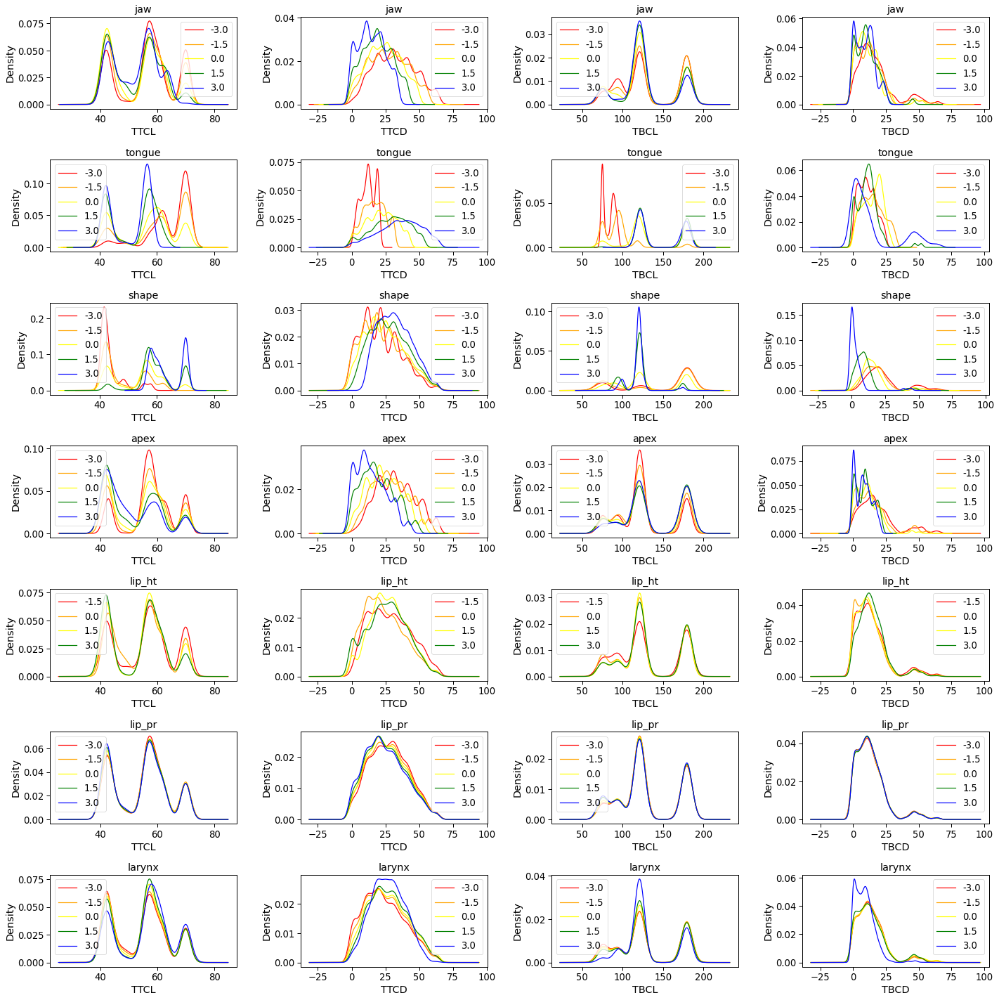

In [24]:
# Across each Maeda parameter, visualize the change in distribution for each task parameter
def dist_across_task_params(df):
    fig = plt.figure(figsize=(20,20))
    i = 1
    for am in df.columns:
        for t in ['TTCL','TTCD','TBCL','TBCD']:
            ax = fig.add_subplot(7,4,i)
            ax.set_title(am)
            ax.set_xlabel(t)
            c = 0
            for val in np.sort(list(set(df[am]))):
                task_params_sub = task_params[df[am] == val]
                task_params_sub[t].plot.kde(color=color_list[c],label=val)
                #ax.hist(task_params_sub[t],alpha=0.2,color=color_list[c],bins=50)
                c += 1
            i += 1
            ax.legend()
    plt.tight_layout()
    plt.show()
dist_across_task_params(AMs)

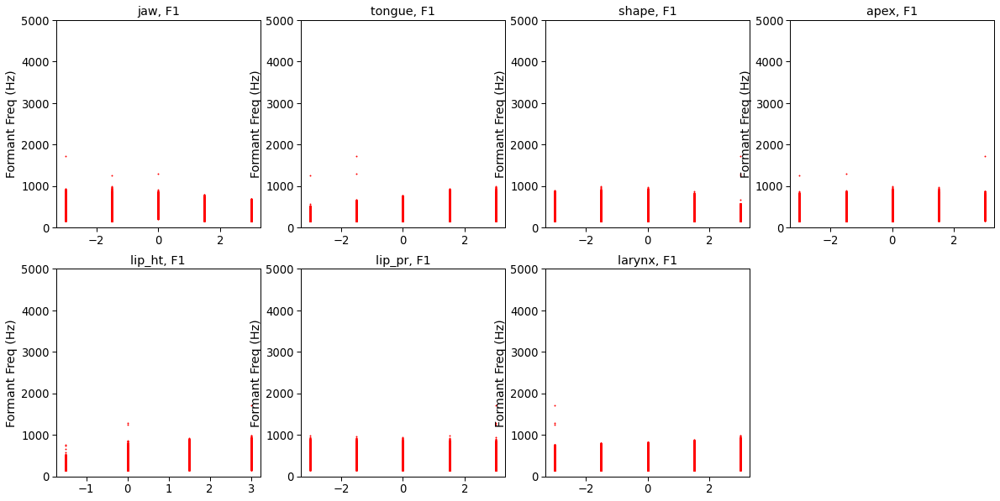

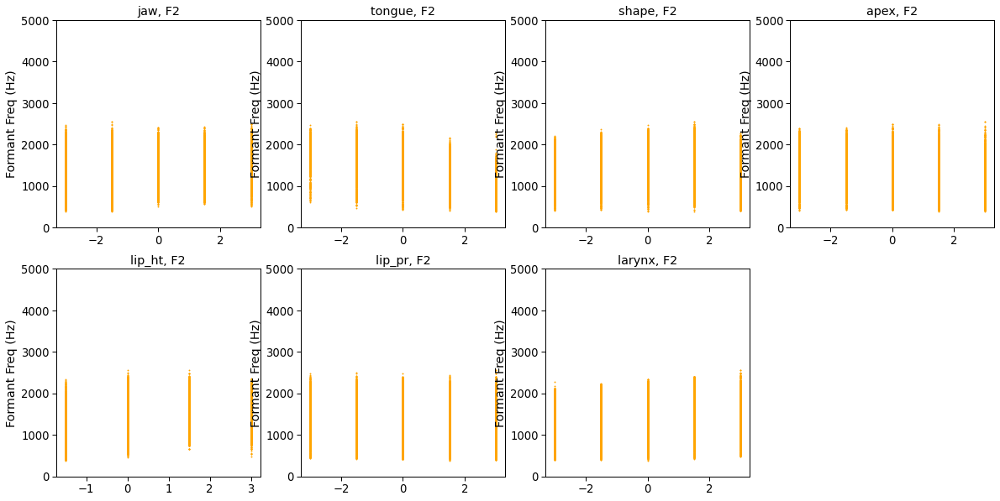

In [32]:
#articulatory params vs formants
def single_artics_vs_formants(formant):
    fig = plt.figure(figsize=(20,10))
    i = 1
    for am in AMs.columns:
        ax = fig.add_subplot(2,4,i)
        ax.scatter(AMs[am],formants[formant-1],color=color_list[formant-1],marker='.',label='F'+str(f+1),s=5)
        i += 1
        ax.set_title(am + ', F' + str(formant))
        ax.set_ylabel('Formant Freq (Hz)')
        ax.set_ylim(0,5000)
    plt.show()
single_artics_vs_formants(1)
single_artics_vs_formants(2)

In [33]:
# 3D plot tongue-shape-apex with F1
i = 0
x = AMs['tongue']
y = AMs['shape']
z = AMs['apex']
hue = formants[0]
fig = go.Figure(data=[go.Scatter3d(x=x, y=y, z=z,mode='markers',marker=dict(color=hue,size=3,colorscale='prgn',colorbar=dict(thickness=20,title='F1')))])
fig.update_layout(
title={
    'text':'Tongue shape F1',
    'y':0.9,
    'x':0.5,
    'xanchor':'center',
    'yanchor':'top'},
scene = dict(
                xaxis_title='tongue',
                yaxis_title='shape',
                zaxis_title='apex'),
                width=700,
                margin=dict(r=20, b=10, l=10, t=10),
font=dict(
    family="Courier New, monospace",
    size=12,
    color="black")
)
fig.show()

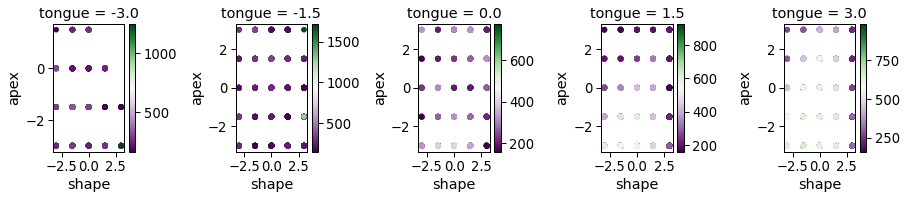

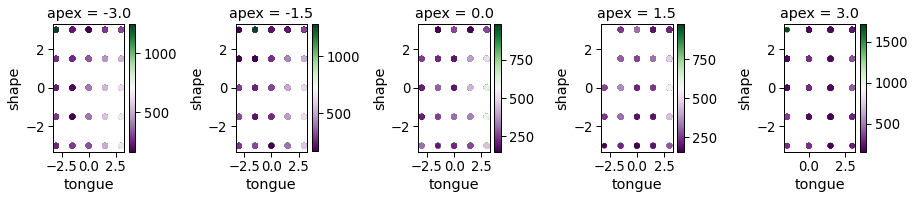

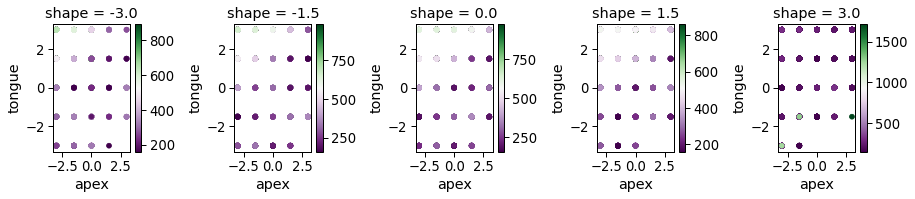

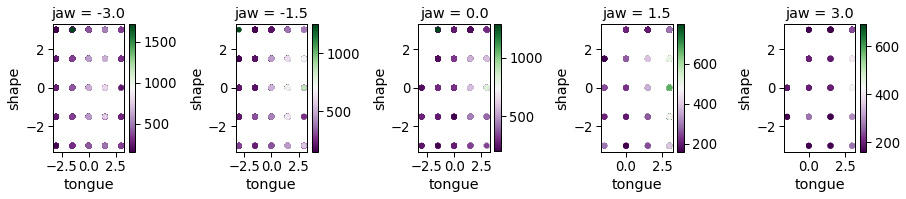

In [34]:
def three_artics_vs_formant(artic1,artic2,artic3,formant):
    artic3_vals = np.sort(list(set(AMs[artic3])))
    fig = plt.figure(figsize=(15,3))
    cmap=plt.cm.get_cmap("PRGn")
    for i,val in enumerate(artic3_vals):
        ax = fig.add_subplot(1,len(artic3_vals)+1,i+1)
        AMs_sub = AMs[AMs[artic3] == val]
        formants_sub = formants[AMs[artic3] == val]
        ax.scatter(AMs_sub[artic1],AMs_sub[artic2],c=formants_sub[formant-1],cmap=cmap)
        ax.set_xlabel(artic1)
        ax.set_ylabel(artic2)
        ax.set_title(artic3 + ' = ' + str(val))
        minF = formants_sub[formant-1].min()
        maxF = formants_sub[formant-1].max()
        norm = colors.Normalize(minF,maxF)
        fig.colorbar(cm.ScalarMappable(norm=norm,cmap=cmap))
    plt.tight_layout()
    plt.show()
three_artics_vs_formant('shape','apex','tongue',1)
three_artics_vs_formant('tongue','shape','apex',1)
three_artics_vs_formant('apex','tongue','shape',1)
three_artics_vs_formant('tongue','shape','jaw',1)

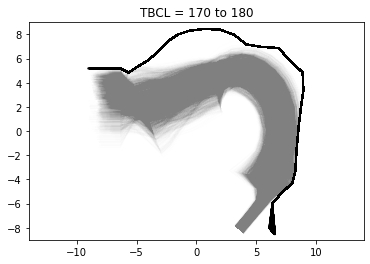

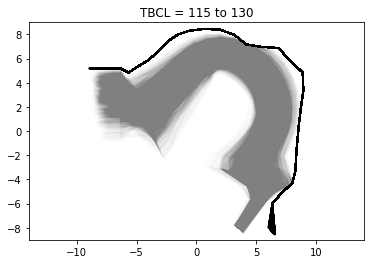

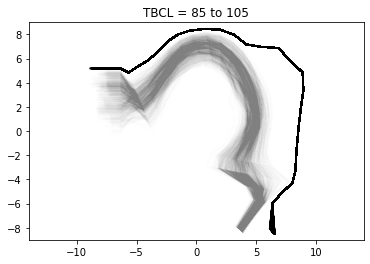

In [19]:
int_color_list = ['red','orange','yellow']
ext_color_list = ['black','black','black']
def vocal_tract_median(maeda_df,task_params_df,task_params_col,slice_min, slice_max, analysis_type,lines_to_plot,show_all=False):
    TC = np.array([1,1,0,0], 'float32')
    PC = np.array([0.00114,35000,1600,1.5,300000], 'float32')
    anc = 0.0
    AM_slice = maeda_df.loc[(task_params_df[task_params_col] >= slice_min) & (task_params_df[task_params_col] <= slice_max)]
    internal_x_ac = np.zeros((AM_slice.shape[0],29))
    internal_y_ac = np.zeros((AM_slice.shape[0],29))
    external_x_ac = np.zeros((AM_slice.shape[0],29))
    external_y_ac = np.zeros((AM_slice.shape[0],29))
    j = 0
    fig = plt.figure()
    ax = fig.add_subplot(1,1,1)
    for i in AM_slice.index:
        AM = np.array(maeda_df.loc[i], 'float32')
        formant,internal_x,internal_y,external_x,external_y= mda.maedaplant(5,29,29,29,29,TC,PC,AM,anc)
        internal_x_ac[j,:] = internal_x-10
        internal_y_ac[j,:] = internal_y-10
        external_x_ac[j,:] = external_x-10
        external_y_ac[j,:] = external_y-10
        j += 1
        if show_all:
            ax.plot(internal_x-10,internal_y-10,color='gray',alpha = 0.005)
            ax.plot(external_x-10,external_y-10,color='black')
    if analysis_type == 'percentile':
        for c,pc in enumerate(lines_to_plot):
            int_x1 = np.percentile(internal_x_ac,pc,0)
            int_y1 = np.percentile(internal_y_ac,pc,0)
            ext_x1 = np.percentile(external_x_ac,pc,0)
            ext_y1 = np.percentile(external_y_ac,pc,0)
            int_x2 = np.percentile(internal_x_ac,100-pc,0)
            int_y2 = np.percentile(internal_y_ac,100-pc,0)
            ext_x2 = np.percentile(external_x_ac,100-pc,0)
            ext_y2 = np.percentile(external_y_ac,100-pc,0)
            ax.plot(int_x1,int_y1,color=int_color_list[c])
            ax.plot(ext_x1,ext_y1,color=ext_color_list[c])
            ax.plot(int_x2,int_y2,color=int_color_list[c])
            ax.plot(ext_x2,ext_y2,color=ext_color_list[c])
    if analysis_type == 'stdev':
        int_x_mean = np.mean(internal_x_ac,axis=0)
        int_y_mean = np.mean(internal_y_ac,axis=0)
        ext_x_mean = np.mean(external_x_ac,axis=0)
        ext_y_mean = np.mean(external_y_ac,axis=0)
        int_x_std = np.std(internal_x_ac,axis=0)
        int_y_std = np.std(internal_y_ac,axis=0)
        ext_x_std = np.std(external_x_ac,axis=0)
        ext_y_std = np.std(external_y_ac,axis=0)
        for c,f in enumerate(lines_to_plot):
            ax.plot(int_x_mean+f*int_x_std,int_y_mean+f*int_y_std,color=int_color_list[c])
            ax.plot(int_x_mean-f*int_x_std,int_y_mean-f*int_y_std,color=int_color_list[c])
            ax.plot(ext_x_mean+f*ext_x_std,ext_y_mean+f*ext_y_std,color=ext_color_list[c])
            ax.plot(ext_x_mean-f*ext_x_std,ext_y_mean-f*ext_y_std,color=ext_color_list[c])
    ax.set_xlim([-14,14])
    ax.set_ylim([-9,9])
    plt.title(task_params_col + ' = ' + str(slice_min) + ' to ' + str(slice_max))
    plt.show()
int_color_list = ['red','yellow']
ext_color_list = ['black','black']
vocal_tract_median(AMs_rw,task_params_rw,'TBCL',170,180,analysis_type=None,lines_to_plot=[50,25],show_all=True)
vocal_tract_median(AMs_rw,task_params_rw,'TBCL',115,130,analysis_type=None,lines_to_plot=[50,25],show_all=True)
vocal_tract_median(AMs_rw,task_params_rw,'TBCL',85,105,analysis_type=None,lines_to_plot=[50,25],show_all=True)

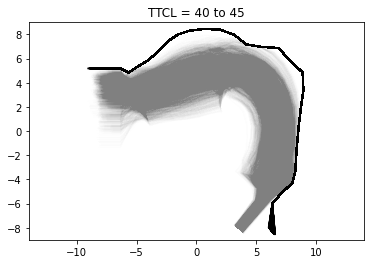

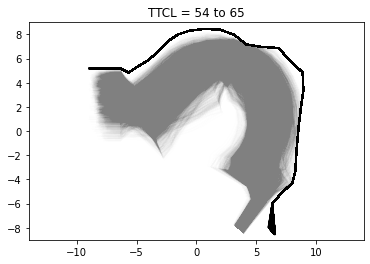

In [20]:
vocal_tract_median(AMs_rw,task_params_rw,'TTCL',40,45,analysis_type=None,lines_to_plot=[50,25],show_all=True)
vocal_tract_median(AMs_rw,task_params_rw,'TTCL',54,65,analysis_type=None,lines_to_plot=[50,25],show_all=True)

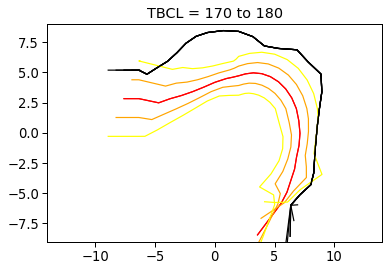

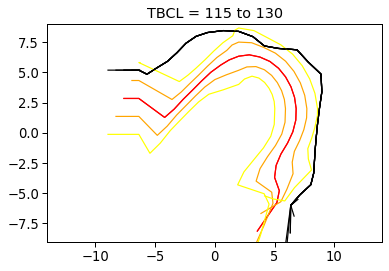

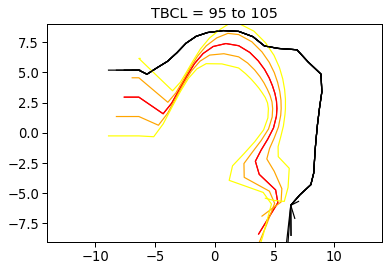

In [37]:
int_color_list = ['red','orange','yellow']
ext_color_list = ['black','black','black']
vocal_tract_median(AMs,'TBCL',170,180,analysis_type='stdev',lines_to_plot=[0,1,2])
vocal_tract_median(AMs,'TBCL',115,130,analysis_type='stdev',lines_to_plot=[0,1,2])
vocal_tract_median(AMs,'TBCL',95,105,analysis_type='stdev',lines_to_plot=[0,1,2])

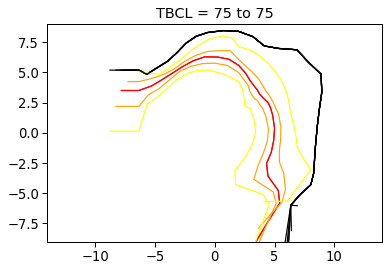

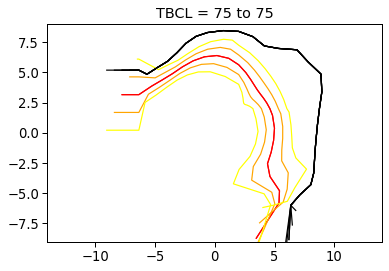

In [38]:
vocal_tract_median(AMs,'TBCL',75,75,analysis_type='percentile',lines_to_plot=[50,25,0])
vocal_tract_median(AMs,'TBCL',75,75,analysis_type='stdev',lines_to_plot=[0,1,2])

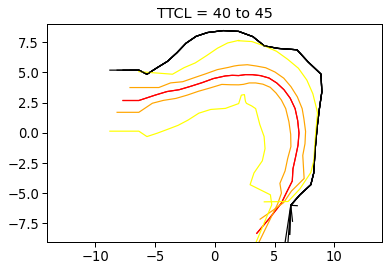

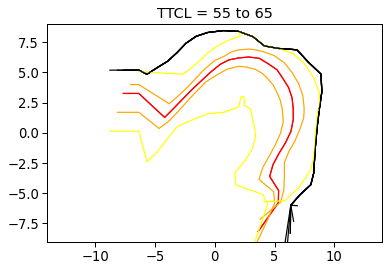

In [39]:
vocal_tract_median(AMs,'TTCL',40,45,analysis_type='percentile',lines_to_plot=[50,25,0])
vocal_tract_median(AMs,'TTCL',55,65,analysis_type='percentile',lines_to_plot=[50,25,0])

In [17]:
AMs_rw['RW'] = [0] * AMs_rw.shape[0]
n = 0
step = 0.25
for i in AMs_rw.index[1:]:
    prev_point = AMs_rw.iloc[i-1,:]
    point = AMs_rw.iloc[i,:]
    for j,param in enumerate(point[0:6]):
        if np.abs(param - prev_point[j]) > step:
            n += 1
            break
    AMs_rw.loc[i,'RW'] = n
AMs_rw

,jaw,tongue,shape,apex,lip_ht,lip_pr,RW
0,-1.284626,2.114371,2.850039,2.309120,-0.842953,0.593154,0
1,-1.357228,2.034466,2.689080,2.177967,-1.070522,0.595869,0
2,-1.419102,2.080868,2.754050,1.999267,-0.853601,0.819059,0
3,-1.367954,2.024752,2.685644,1.851440,-0.965219,0.692327,0
4,-1.531150,2.258056,2.914151,1.900426,-0.849568,0.612520,0
...,...,...,...,...,...,...,...
20005,-0.485733,0.126509,0.551746,1.794214,0.616260,1.893087,675
20006,-0.248484,0.044082,0.460490,1.707572,0.500190,1.703861,675
20007,-0.429863,0.022872,0.378230,1.901788,0.456064,1.625292,675
20008,-0.362384,-0.145535,0.267262,1.931347,0.446401,1.658263,675


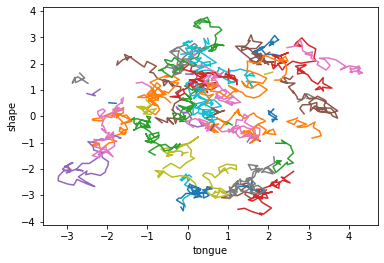

In [14]:
plt.figure()
ax = plt.subplot(1,1,1)
for rw in AMs_rw['RW'].unique()[0:50]:
    m_walk = AMs_rw[AMs_rw['RW'] == rw]
    ax.plot(m_walk['tongue'],m_walk['shape'])
ax.set_xlabel('tongue')
ax.set_ylabel('shape')
plt.show()

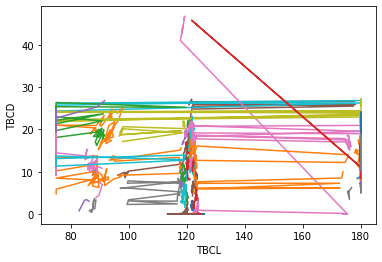

In [15]:
plt.figure()
ax = plt.subplot(1,1,1)
for rw in AMs_rw['RW'].unique()[0:50]:
    t_walk = task_params_rw[AMs_rw['RW'] == rw]
    ax.plot(t_walk['TBCL'],t_walk['TBCD'])
ax.set_xlabel('TBCL')
ax.set_ylabel('TBCD')
plt.show()

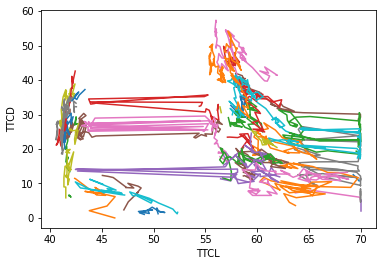

In [16]:
plt.figure()
ax = plt.subplot(1,1,1)
for rw in AMs_rw['RW'].unique()[0:50]:
    t_walk = task_params_rw[AMs_rw['RW'] == rw]
    ax.plot(t_walk['TTCL'],t_walk['TTCD'])
ax.set_xlabel('TTCL')
ax.set_ylabel('TTCD')
plt.show()

In [18]:
def vocal_tract_trajectory(AM_slice):
    AM_slice_copy = AM_slice.copy()
    del AM_slice_copy['RW']
    TC = np.array([1,1,0,0], 'float32')
    PC = np.array([0.00114,35000,1600,1.5,300000], 'float32')
    anc = 0.0
    fig = plt.figure()
    ax = fig.add_subplot(1,1,1)
    for i,index in enumerate(AM_slice_copy.index):
        AM_base = np.zeros(7,dtype='float32')
        AM = np.array(AM_slice_copy.iloc[i,:], 'float32')
        AM_base[0:len(AM)] = AM
        formant,internal_x,internal_y,external_x,external_y= mda.maedaplant(5,29,29,29,29,TC,PC,AM_base,anc)
        color = i/AM_slice.shape[0]
        ax.plot(internal_x-10,internal_y-10,color=(1-color,0,color))
        ax.plot(external_x-10,external_y-10,color='black')
    ax.set_xlim([-14,14])
    ax.set_ylim([-9,9])
    plt.title('Random Walk')
    plt.show()

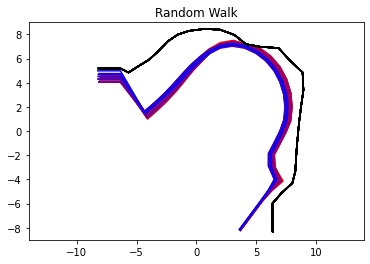

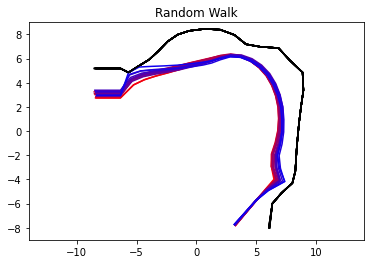

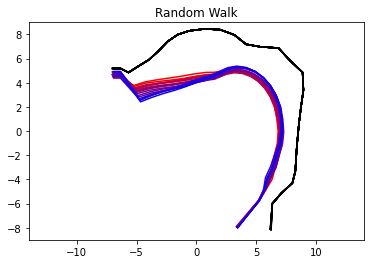

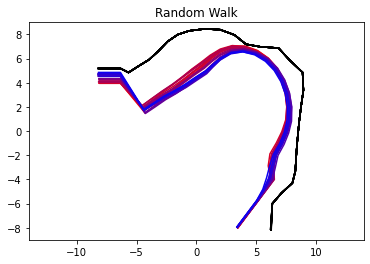

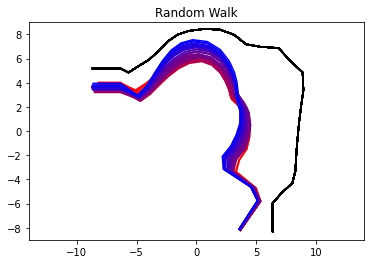

...

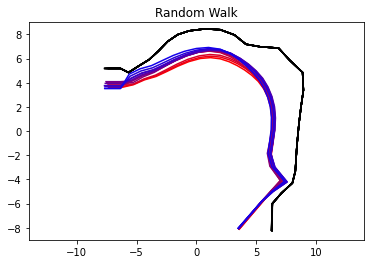

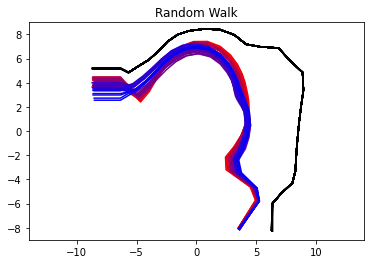

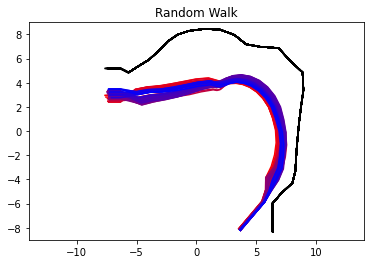

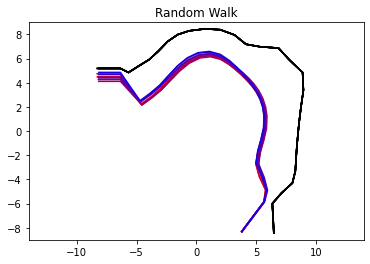

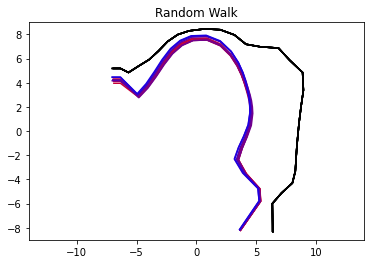

In [36]:
for rw in AMs_rw['RW'].unique()[0:50]:
    m_walk = AMs_rw[AMs_rw['RW'] == rw]
    vocal_tract_trajectory(m_walk)

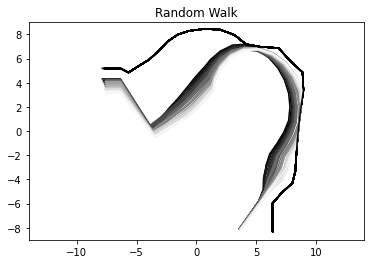

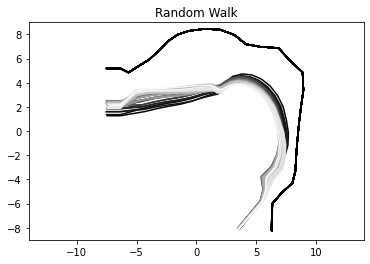

In [26]:
vocal_tract_trajectory(AMs_rw[AMs_rw['RW'] == 16])
vocal_tract_trajectory(AMs_rw[AMs_rw['RW'] == 43])

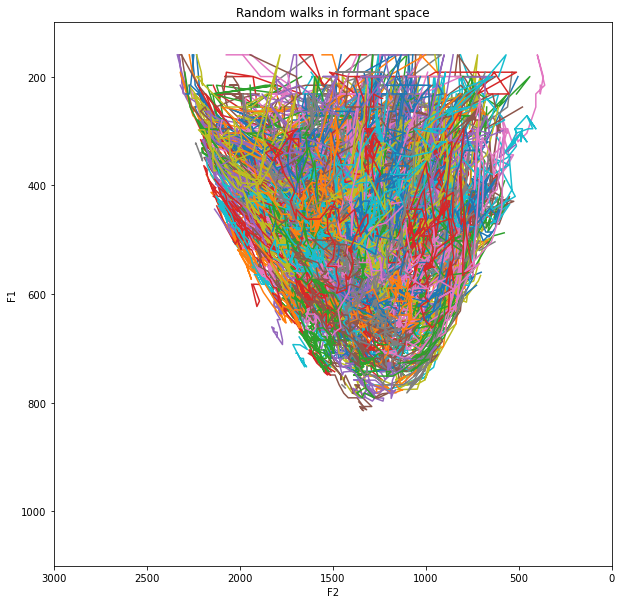

In [27]:
#formant_graph(formants_rw,'Random Walk Data')
plt.figure(figsize=(10,10))
ax = plt.subplot(1,1,1)
for rw in AMs_rw['RW'].unique():
    f_walk = formants_rw[AMs_rw['RW'] == rw]
    ax.plot(f_walk[1],f_walk[0])
ax.invert_xaxis()
ax.invert_yaxis()
ax.set_xlabel('F2')
ax.set_ylabel('F1')
ax.set_xlim([3000,0])
ax.set_ylim([1100,100])
ax.set_title('Random walks in formant space')
plt.show()

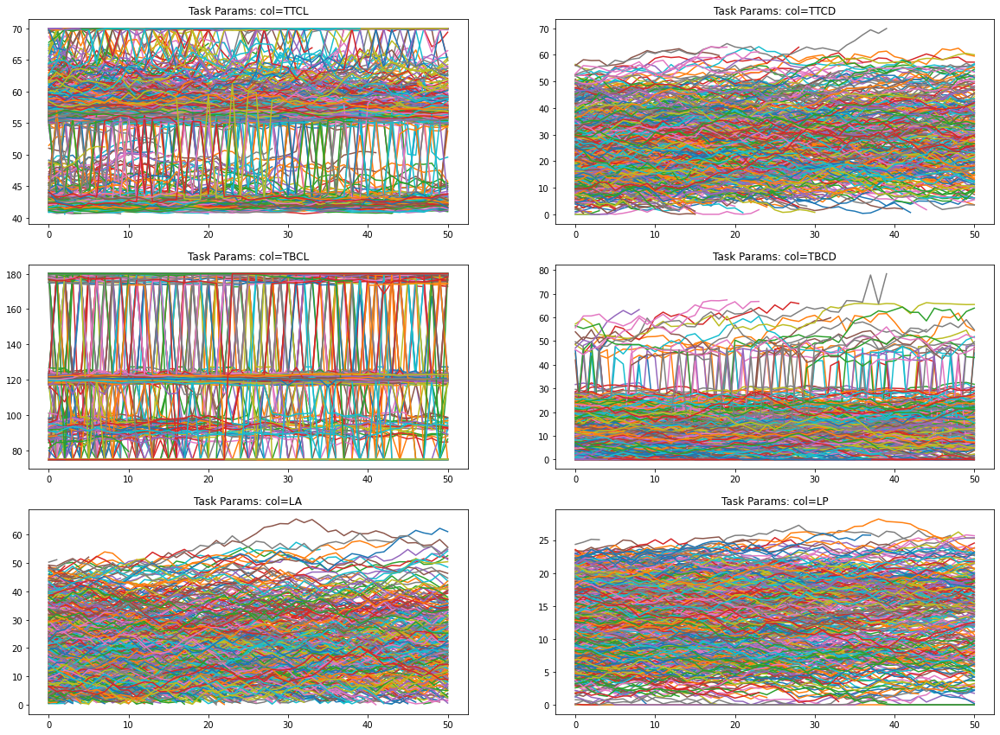

In [23]:
# track task parameters over the course of random walk
def param_over_trials(df,title):
    fig = plt.figure(figsize=(20,20))
    for i,t in enumerate(df.columns):
        ax = plt.subplot(4,2,i+1)
        for rw in AMs_rw['RW'].unique():
            t_walk = df[AMs_rw['RW'] == rw]
            t_walk.reset_index(drop=True,inplace=True)
            ax.plot(t_walk.index,t_walk[t])
        ax.set_title(title + str(t))
param_over_trials(task_params_rw,'Task Params: col=')

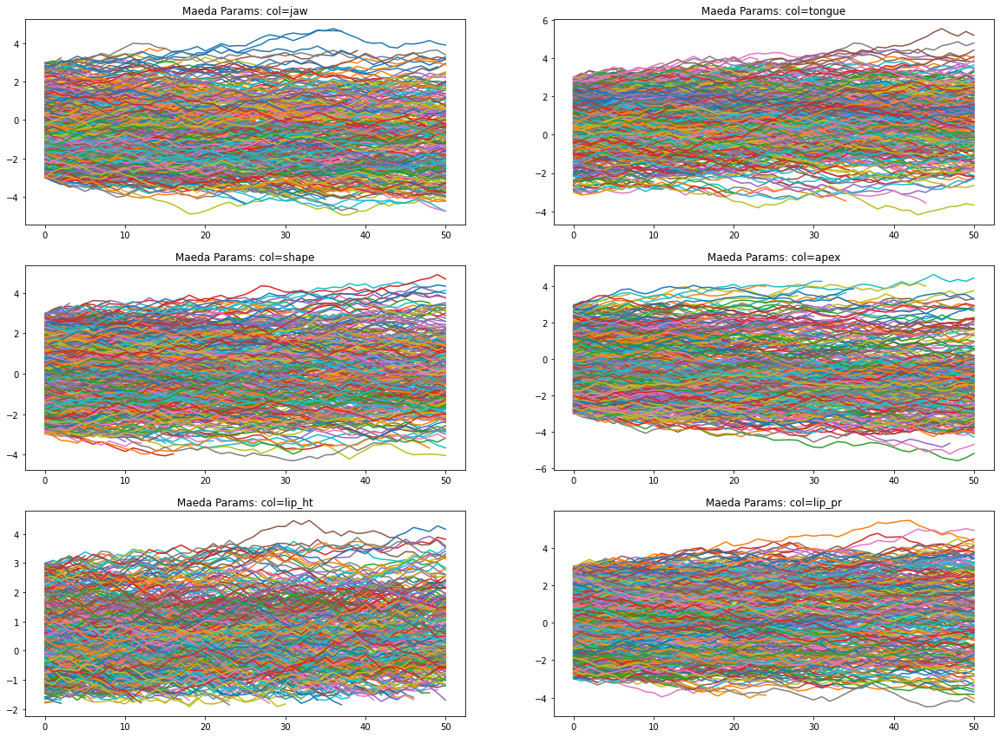

In [24]:
param_over_trials(AMs_rw.iloc[:,0:6],'Maeda Params: col=')

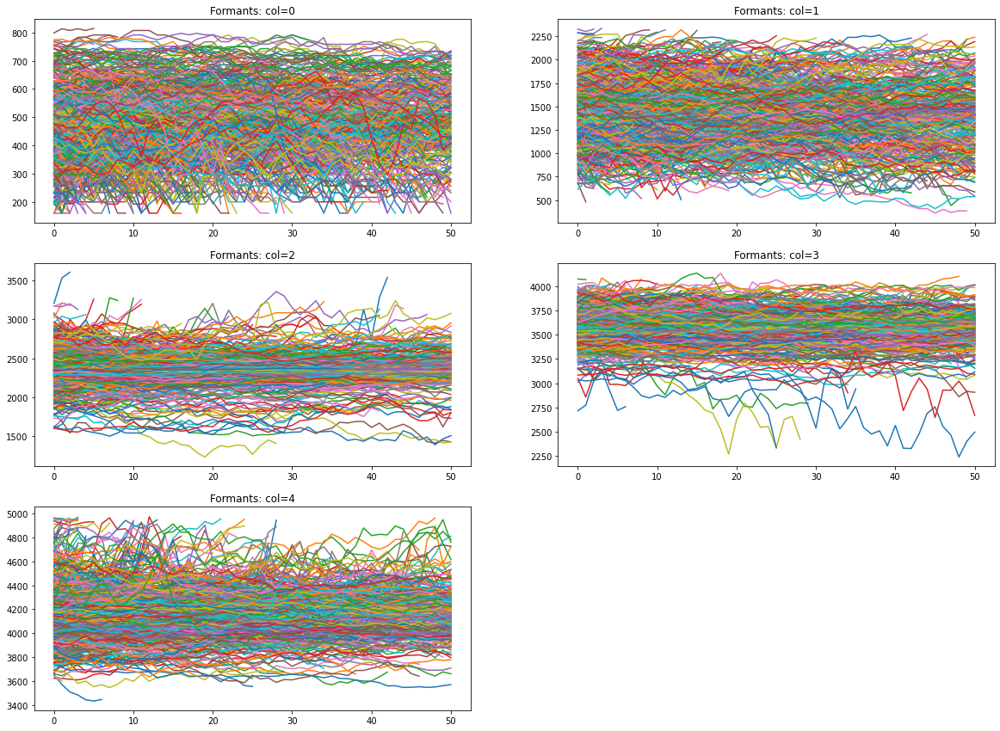

In [25]:
param_over_trials(formants_rw,'Formants: col=')

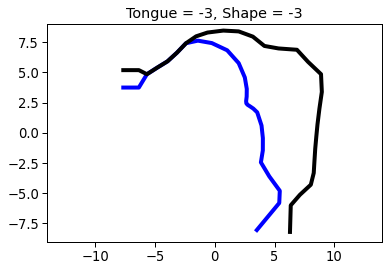

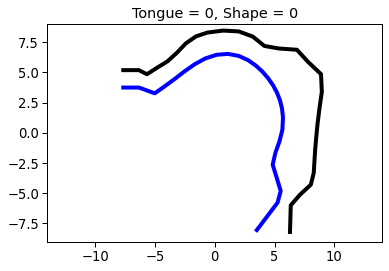

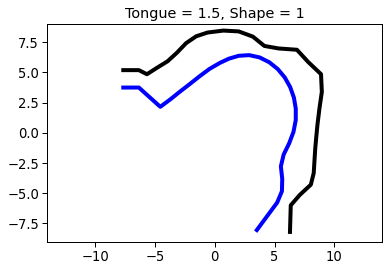

In [54]:
def plot_vocal_tract(AM,title):
    fig = plt.figure()
    ax = fig.add_subplot(1,1,1)
    TC = np.array([1,1,0,0], 'float32')
    PC = np.array([0.00114,35000,1600,1.5,300000], 'float32')
    anc = 0.0
    formant,internal_x,internal_y,external_x,external_y= mda.maedaplant(5,29,29,29,29,TC,PC,AM,anc)
    ax.plot(internal_x-10,internal_y-10,color='blue',linewidth=4)
    ax.plot(external_x-10,external_y-10,color='black',linewidth=4)
    ax.set_xlim([-14,14])
    ax.set_ylim([-9,9])
    plt.title(title)
    plt.show()
plot_vocal_tract(np.array([0,-3,-3,0,0,0,0],dtype='float32'),'Tongue = -3, Shape = -3')
plot_vocal_tract(np.array([0,0,0,0,0,0,0],dtype='float32'),'Tongue = 0, Shape = 0')
plot_vocal_tract(np.array([0,1.5,1,0,0,0,0],dtype='float32'),'Tongue = 1.5, Shape = 1')